In [7]:
import screed
import re
import pandas as pd
import numpy as np
import seaborn as sns
import os

#contig_file = "./ma.contigs.fasta"
contig_file = "./asm_second.contigs.fasta"

In [8]:
rx = re.compile(r'(\S+) len=(\d+) reads=(\d+) class=(\w+) suggestRepeat=(\w+) suggestBubble=(\w+) suggestCircular=(\w+)')


temp = {}


with screed.open(contig_file) as seqfile:
    for read in seqfile:
        #print(read.name)

        match_rx = rx.match(read.name)

        if match_rx:
            temp[match_rx.group(1)] = [int(match_rx.group(2)), int(match_rx.group(3)), match_rx.group(4), match_rx.group(5), match_rx.group(6), match_rx.group(7)]

df = pd.DataFrame.from_dict(temp, orient="index", columns=["len", "reads", "class", "repeat", "bubble", "circular"])
df.index.name = "bin"

<AxesSubplot:xlabel='len'>

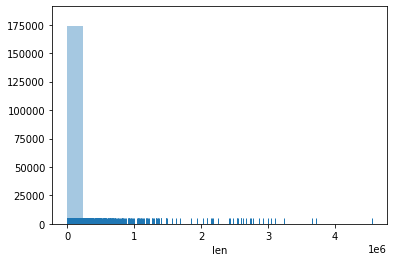

In [9]:
sns.distplot(df["len"], bins=20, kde=False, rug=True)

<AxesSubplot:xlabel='reads'>

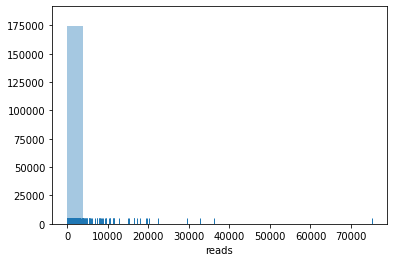

In [10]:
sns.distplot(df["reads"], bins=20, kde=False, rug=True)

In [11]:
len(df[df["len"] > 1000000])

71

In [23]:

output_folder = "./bigger_than_1m"

cutoff = 1000000

with screed.open(contig_file) as seqfile:
    for read in seqfile:
        #print(read.name)

        match_rx = rx.match(read.name)

        if match_rx:
            if int(match_rx.group(2)) > cutoff or match_rx.group(7) == "yes":
                output_file = os.path.join(output_folder, match_rx.group(1) + ".fasta")
                with open(output_file, 'w') as the_file:
                    the_file.write(f'>{read.name}\n{read.sequence}')

In [24]:
### get the fasta larger than 1m
output_contig_list = "./bigger_than_1m_list.txt"

cutoff = 1000000

contig_list = set()

with screed.open(contig_file) as seqfile:
    for read in seqfile:
        #print(read.name)

        match_rx = rx.match(read.name)

        if match_rx:
            if int(match_rx.group(2)) > cutoff or match_rx.group(7) == "yes":
                contig_list.add(read.name.split()[0])
                #output_file = os.path.join(output_folder, match_rx.group(1) + ".fasta")
                #with open(output_file, 'w') as the_file:
                #    the_file.write(f'>{read.name}\n{read.sequence}')

with open(output_contig_list, 'w') as contig_list_file:
    contig_list_file.write("\n".join(contig_list))

In [25]:
checkm = pd.read_csv("./bigger_than_1m_checkm.txt", sep="\t")

In [26]:
checkm.set_index("bin")

,marker lineage,Completeness,Contamination,Mean contig length,N50 (contigs),Coding density,# contigs,Genome size,GC
bin,,,,,,,,,
tig00056951,root,0.00,0.00,27023.0,27023,0.93,1,27023,0.44
tig00015855,root,0.00,0.00,145560.0,145560,0.94,1,145560,0.30
tig00028108,root,0.00,0.00,48088.0,48088,0.88,1,48088,0.29
tig00019040,root,0.00,0.00,115998.0,115998,0.88,1,115998,0.52
tig00033018,root,0.00,0.00,44965.0,44965,0.57,1,44965,0.29
...,...,...,...,...,...,...,...,...,...
tig00003550,g__Prevotella,21.68,0.45,1341249.0,1341249,0.86,1,1341249,0.49
tig00001181,f__Spirochaetaceae,98.60,3.50,2620136.0,2620136,0.91,1,2620136,0.36
tig00022374,root,0.00,0.00,83231.0,83231,0.93,1,83231,0.54


In [27]:
bigger_than_1m = df.merge(checkm, left_on="bin", right_on="bin")

In [28]:
bigger_than_1m[(bigger_than_1m["circular"] == "yes") & (bigger_than_1m["len"] > 500000)]

,bin,len,reads,class,repeat,bubble,circular,marker lineage,Completeness,Contamination,Mean contig length,N50 (contigs),Coding density,# contigs,Genome size,GC
3,tig00000065,2669046,22445,contig,no,no,yes,g__Prevotella,86.12,0.88,2669045.0,2669045,0.87,1,2669045,0.48
8,tig00000413,2918578,15045,contig,no,no,yes,f__Veillonellaceae,97.78,0.62,2918577.0,2918577,0.88,1,2918577,0.56
15,tig00001208,2021985,19703,contig,no,no,yes,g__Prevotella,84.70,0.59,2021984.0,2021984,0.90,1,2021984,0.43
26,tig00002470,2587651,7745,contig,no,no,yes,f__Spirochaetaceae,97.20,0.70,2587650.0,2587650,0.90,1,2587650,0.36
28,tig00003060,3045365,17105,contig,no,no,yes,f__Lachnospiraceae,99.52,2.69,3045364.0,3045364,0.88,1,3045364,0.41
37,tig00004002,2244279,4127,contig,no,no,yes,k__Bacteria,98.39,0.18,2244278.0,2244278,0.90,1,2244278,0.42
637,tig03626502,2549186,16582,contig,no,no,yes,f__Spirochaetaceae,97.20,0.35,2549185.0,2549185,0.90,1,2549185,0.36


In [29]:
bigger_than_1m[(bigger_than_1m["Completeness"] > 90) & (bigger_than_1m["Contamination"] < 10)]

,bin,len,reads,class,repeat,bubble,circular,marker lineage,Completeness,Contamination,Mean contig length,N50 (contigs),Coding density,# contigs,Genome size,GC
8,tig00000413,2918578,15045,contig,no,no,yes,f__Veillonellaceae,97.78,0.62,2918577.0,2918577,0.88,1,2918577,0.56
9,tig00000512,2594977,8238,contig,no,no,no,f__Lachnospiraceae,95.89,0.55,2594976.0,2594976,0.91,1,2594976,0.43
14,tig00001181,2620137,11578,contig,no,no,no,f__Spirochaetaceae,98.60,3.50,2620136.0,2620136,0.91,1,2620136,0.36
17,tig00001299,3651273,11399,contig,no,no,no,o__Bacteroidales,99.26,0.00,3651272.0,3651272,0.89,1,3651272,0.46
19,tig00001845,3110106,11518,contig,no,no,no,f__Spirochaetaceae,98.60,6.29,3110105.0,3110105,0.89,1,3110105,0.39
20,tig00002151,2722258,10590,contig,no,no,no,o__Bacteroidales,97.04,0.45,2722257.0,2722257,0.86,1,2722257,0.53
26,tig00002470,2587651,7745,contig,no,no,yes,f__Spirochaetaceae,97.20,0.70,2587650.0,2587650,0.90,1,2587650,0.36
28,tig00003060,3045365,17105,contig,no,no,yes,f__Lachnospiraceae,99.52,2.69,3045364.0,3045364,0.88,1,3045364,0.41
32,tig00003488,2779531,9472,contig,no,no,no,o__Clostridiales,99.33,0.67,2779530.0,2779530,0.90,1,2779530,0.40
36,tig00003729,2433060,9341,contig,no,no,no,p__Bacteroidetes,95.24,1.90,2433059.0,2433059,0.90,1,2433059,0.47


In [19]:
from pathlib import Path
from numpy import loadtxt

mapping_folder = "./bigger_than_1m_mapping_filter_all"


total_reads = dict()
for line in open("illumina_read_counts.tsv", 'r'):
    fields = line.strip().split("\t")
    total_reads[fields[0]] = float(fields[1])

#print (total_reads)
#total_reads = pd.read_csv("illumina_read_counts.tsv", sep="\t")

for path in Path(mapping_folder).rglob('*.tsv'):
    sample = path.name.replace(".tsv", "")
    #print (sample)

    mapping_df = pd.read_csv(os.path.join(mapping_folder, path.name), sep="\t")
    mapping_df.columns = ["bin", sample]

    mapping_df[sample] = 1e+6 * mapping_df[sample].astype(float) / total_reads[sample]

    bigger_than_1m = bigger_than_1m.merge(mapping_df, left_on="bin", right_on="bin")
    #print (mapping_df[sample])
    #print (1000000 * mapping_df[sample].astype(float), total_reads[total_reads["sample"] == sample]["reads"])
    #print (total_reads[total_reads["sample"] == sample]["reads"].astype(float))

In [20]:
bigger_than_1m[(bigger_than_1m["Completeness"] > 90) & (bigger_than_1m["Contamination"] < 10)]

,bin,len,reads,class,repeat,bubble,circular,marker lineage,Completeness,Contamination,...,N50 (contigs),Coding density,# contigs,Genome size,Soarial-687,Soarial-733,Soarial-661,Fliege758,Soarial-669,Soarial-671
0,tig00000003,9702,6,contig,no,yes,no,o__Pseudomonadales,100.00,0.54,...,4873796,0.89,1,4873796,26.702555,15.685302,15.725128,116731.131328,15.606488,25.054226
1,tig00000034,21514,51,contig,no,yes,no,f__Enterobacteriaceae,100.00,1.00,...,5494457,0.87,1,5494457,52.004627,34.531519,38.035509,31223.521261,43.318943,55.039531
2,tig00000314,38301,54,contig,no,yes,no,f__Enterobacteriaceae,99.67,0.66,...,4755142,0.88,1,4755142,41.547682,26.957248,27.675091,24798.803391,28.879295,39.557397
4,tig00000365,16842,6,contig,no,yes,no,f__Enterobacteriaceae,99.92,0.89,...,5025645,0.87,1,5025645,53.498476,34.054400,36.900121,26556.925046,40.693552,49.274521
5,tig00000561,174059,967,contig,no,yes,no,f__Moraxellaceae,100.00,0.41,...,3770128,0.87,1,3770128,58.960362,16.341341,18.620369,95092.949728,22.899239,32.197038
8,tig00001019,6775,4,contig,no,yes,no,c__Gammaproteobacteria,100.00,1.17,...,2579118,0.83,1,2579118,111.571865,18.846218,19.982835,23931.457767,19.252863,139.049144
11,tig00001097,77440,110,contig,no,yes,no,f__Spirochaetaceae,97.20,1.40,...,2550377,0.91,1,2550377,909.240676,26798.725375,825.370547,2.202859,825.247738,174.509395
12,tig00001103,9187,6,contig,no,yes,no,f__Lachnospiraceae,99.21,2.09,...,3020568,0.88,1,3020568,1441.097688,30274.242290,2467.085305,1.982573,3306.825155,7633.924902
13,tig00001169,60448,155,contig,no,no,no,f__Moraxellaceae,99.66,0.68,...,3497859,0.86,1,3497859,307.919674,20.575776,21.203377,34161.373948,24.795354,51.123675
22,tig00001651,12076,6,contig,no,yes,no,f__Veillonellaceae,97.78,0.62,...,2919143,0.88,1,2919143,402.545687,16589.800737,409.193955,8.811435,828.894114,371.317414


In [21]:
bigger_than_1m

,bin,len,reads,class,repeat,bubble,circular,marker lineage,Completeness,Contamination,...,N50 (contigs),Coding density,# contigs,Genome size,Soarial-687,Soarial-733,Soarial-661,Fliege758,Soarial-669,Soarial-671
0,tig00000003,9702,6,contig,no,yes,no,o__Pseudomonadales,100.00,0.54,...,4873796,0.89,1,4873796,26.702555,15.685302,15.725128,116731.131328,15.606488,25.054226
1,tig00000034,21514,51,contig,no,yes,no,f__Enterobacteriaceae,100.00,1.00,...,5494457,0.87,1,5494457,52.004627,34.531519,38.035509,31223.521261,43.318943,55.039531
2,tig00000314,38301,54,contig,no,yes,no,f__Enterobacteriaceae,99.67,0.66,...,4755142,0.88,1,4755142,41.547682,26.957248,27.675091,24798.803391,28.879295,39.557397
3,tig00000333,13522,12,contig,no,yes,no,c__Gammaproteobacteria,59.46,0.54,...,2273227,0.85,1,2273227,44.161918,15.387102,19.642218,12036.500730,30.483700,39.086044
4,tig00000365,16842,6,contig,no,yes,no,f__Enterobacteriaceae,99.92,0.89,...,5025645,0.87,1,5025645,53.498476,34.054400,36.900121,26556.925046,40.693552,49.274521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210,tig00040891,8145,7,contig,no,no,no,root,0.00,0.00,...,18872,0.37,1,18872,8.449585,32.145922,14.220739,1.702209,4.375651,3.226955
211,tig00041956,19430,19,contig,no,no,no,root,0.00,0.00,...,10676,0.58,1,10676,0.093366,0.000000,0.056769,24.872279,0.583420,0.108774
212,tig00042539,33517,31,contig,no,no,no,root,0.00,0.00,...,5092,0.73,1,5092,0.000000,0.000000,0.766387,95.944515,1.458550,0.145032
213,tig00046381,67822,76,contig,no,no,no,root,0.00,0.00,...,7358,0.78,1,7358,4.248134,1.192799,20.153143,0.000000,2.187825,1.921670


In [22]:
bigger_than_1m.to_csv("/home/sih13/Downloads/bigger_than_1m_checkm.tsv", sep="\t", index=False)